In [2]:
#Uploading relevant libraries 
import pandas as pd
!pip install seaborn --upgrade
import seaborn as sns
sns.set()
!pip install plotly
from IPython.display import IFrame
import scipy as sp
import plotly.express as px
!pip install jupyterlab "ipywidgets>=7.5"
import matplotlib.pyplot as plt
from nltk.corpus import wordnet as wn
from nltk.stem.wordnet import WordNetLemmatizer
lemmatizer = WordNetLemmatizer()
from nltk.tokenize import word_tokenize

import nltk
from nltk.stem import WordNetLemmatizer
from nltk import stem
stemmer = stem.PorterStemmer()
from nltk.corpus import stopwords
nltk.download('stopwords')
stops = set(stopwords.words('english'))
import string
punct = set(string.punctuation)
from collections import Counter
import requests
import numpy as np
import praw 
import datetime
import random
from random import sample

import gensim
from gensim import corpora
import gensim.downloader as api
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from IPython.display import IFrame
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.cluster import AffinityPropagation
from scipy.spatial import distance
!pip install yellowbrick

[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/nicolerodriguezq/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# About this Notebook

Expanding from my previous [work](https://github.com/Nicollevrodriguez/NLP-Corpus-of-Data), this notebook shows the process of coding with NLP methods for data analysis. I am using a ready-to-use corpus of linguistic data that contains the top 10 most popular stories within the subreddit **‘Stories’,** alongside their public responses.

Whilst stories themselves (not limited to the ones contained within this notebook) may be a good linguistic source to understand the creation of narratives and storytelling, the main focus of this notebook is to analyse the public responses to the stories collected. However, I still aim to understand trends in storytelling by exploring the linguistic characteristics through the application of three NLP methods: 

- Topic modelling and text clustering with Term Frequency - Inverse Document Frequency (TF-IDF).
- Sentiment analysis through the Valence-Arousal-Dominance method (VAD).
- Word embeddings with Word2Vec.

These methods will be described during the course of the notebook. 

By the end of this notebook, I aim to uncover why these specific stories garner such considerable engagement. Are they indicative of successful storytelling, or does high engagement entail something else entirely?

In [3]:
#uploading the datasets.
vad = pd.read_excel('vad.xlsx', index_col =0)
sm = pd.read_excel('sensorimotor.xlsx', index_col =0)
df_comments = pd.read_csv('df_comments.csv', index_col =0)
df_posts = pd.read_csv('df_posts.csv', index_col = 0)

In [4]:
#getting rid of comments deleted, as they are shown as 'deleted' within the dataframe. 
df_comments = df_comments[~df_comments['text'].str.contains('deleted', case=False)]
df_comments.reset_index(drop=True, inplace=True)

In [5]:
#Combine the DataFrames of posts and stories.
all_stories_df = pd.concat([df_comments, df_posts], ignore_index=True)

In [6]:
import ast
all_stories_df['tokens'] = all_stories_df['text_lemmatised'].apply(ast.literal_eval).tolist()
df_comments['tokens'] = df_comments['text_lemmatised'].apply(ast.literal_eval).tolist()
df_posts['tokens']= df_posts['text_lemmatised'].apply(ast.literal_eval).tolist()

In [7]:
all_stories_df.head()

,text,datetime,score,subreddit,redditor,type,title,text_lemmatised,valence,arousal,dominance,tokens
0,"Dude, I hate to break it to you but as soon as...",2023-09-30 01:34:12,1779,stories,stpg1222,comment,I thought she took me to the restroom to have ...,"['dude', 'hate', 'break', 'soon', 'farted', 'f...",0.543494,0.640114,0.529571,"[dude, hate, break, soon, farted, front, 2, en..."
1,Coward,2023-09-30 00:38:37,1226,stories,Tall-Remote3112,comment,I thought she took me to the restroom to have ...,['coward'],0.289720,0.463122,0.387136,[coward]
2,Lmao I asked my husband what he would do if th...,2023-09-30 02:13:34,1055,stories,Jilltro,comment,I thought she took me to the restroom to have ...,"['lmao', 'asked', 'husband', 'would', 'happene...",0.548481,0.481526,0.575000,"[lmao, asked, husband, would, happened, sighed..."
3,"Everyone knows the order is drinking, talking,...",2023-09-30 01:24:44,715,stories,oldmanartie,comment,I thought she took me to the restroom to have ...,"['everyone', 'know', 'order', 'drinking', 'tal...",0.671437,0.488964,0.617617,"[everyone, know, order, drinking, talking, dri..."
4,This reminds me of college when my roommates g...,2023-09-30 02:19:20,541,stories,talon2525,comment,I thought she took me to the restroom to have ...,"['reminds', 'college', 'roommate', 'gf', 'came...",0.613123,0.491981,0.567193,"[reminds, college, roommate, gf, came, town, s..."


The column 'text_lemmatised ' comes in the form of a string. While performing Word2Vec I had to convert the column into a list of lists to implement the method properly. To make things more organised, I am adding the column with the list of lists here to standardise all the data frames.

# Topic Modelling 
This method uses linguistics and computational techniques to understand and analyse natural languages (colloquial language). Specifically, it distributes and classifies the words into specific topics (Alabanese, 2021). To achieve this, we standardise our corpus and generate a TF-IDF Matrix, which is an algorithm from Scikit-Learn (a Python library), performing mathematical equations to determine which words are more relevant in a linguistic corpus (Mattingly, 2021). In simple terms, it first checks the frequency of the words (TF) and checks how common they are across the corpus (IDF) (Stecanella, 2019) 

In [8]:
# Creating a TF-IDF matrix
text = all_stories_df['text_lemmatised']
tfidf_vectorizer = TfidfVectorizer(stop_words='english', token_pattern=r"(?u)\b\w\w+\b", lowercase=True)
tfidf_matrix = tfidf_vectorizer.fit_transform(text)
denselist = tfidf_matrix.todense().tolist()
d = pd.DataFrame(denselist, columns=tfidf_vectorizer.get_feature_names_out())

In [9]:
d['story']

0        0.000000
1        0.000000
2        0.000000
3        0.000000
4        0.000000
           ...   
22066    0.068411
22067    0.000000
22068    0.000000
22069    0.000000
22070    0.000000
Name: story, Length: 22071, dtype: float64

The results assign values between 0 and 1 per word within all the dimensions (number of documents) of the corpus, which this time is 22071.

Since 22.000 dimensions can’t be represented visually, I am running Principal Component Analysis (PCA) - a statistical technique that reduces dimensionality into a given number - here we do three.(Whitfield, 2024)

In [10]:
pca = PCA(n_components=3)
comps = pca.fit_transform(d)
pc_df = pd.DataFrame(data=comps, columns=['pc' + str(i) for i in range(1, comps.shape[1] + 1)])

# Clusters

These are the collection of similar texts. To get them, I perform two clustering algorithms: **K-means**, and **Agglomerative Clustering**. They iterate all the data points based on similarity (Mattingly, 2021). However, it would be an arbitrary choice to pick a random number of clusters - which I did at first, but it became evident that this approach resulted in noisy clusters. Each iteration, exploring various cluster counts, demanded over 30 minutes to execute. 

## Visual Aid

The following code performs the Elbow Method to help me determine the optimal number of clusters. It iterates over a range of cluster counts and it shows a visual representation of this (Kink, 2022)



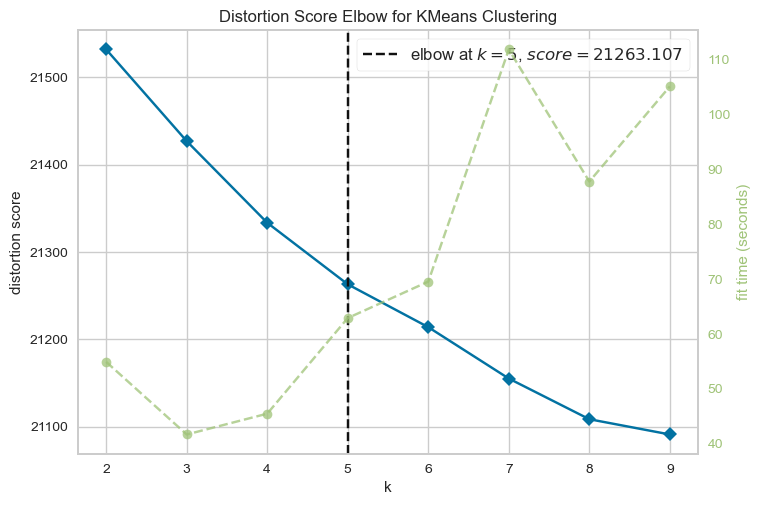

In [9]:
from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt

cluster_colors = ['#b4d2b1', '#568f8b', '#1d4a60', '#cd7e59', '#ddb247', '#d15252', '#7e9a9a', '#9067a7', '#a1786b', '#6d9a66']

fig, ax = plt.subplots()

#the range of clusters
visualizer = KElbowVisualizer(KMeans(n_init=10), k=(2, 10), ax=ax)

#apply it to the data 
visualizer.fit(d)

# Set X-axis ticks
ax.set_xticks(range(2, 10))

# Show the visualizer
visualizer.show()

plt.show()

In [12]:
clustering = AgglomerativeClustering(n_clusters=5, metric='euclidean', linkage='ward').fit(d)

In [11]:
kmeans = KMeans(n_clusters=5, random_state=0, n_init="auto").fit(d)

In [83]:
#making a new dataframe with the clusters and also adding VAD values 
df_all = pd.concat([d, pc_df], axis = 1)
df_all['clusters_ag'] = [str(i) for i in clustering.labels_]
df_all['clusters_knn'] = [str(i) for i in kmeans.labels_]
df_all['text_'] = all_stories_df['text']
df_all['score_'] = all_stories_df['score']
df_all['story_title'] = all_stories_df['title']
df_all['Valence'] = all_stories_df['valence']
df_all['Arousal'] = all_stories_df['arousal']
df_all['Dominance'] = all_stories_df['dominance']
df_all['lemmas'] = all_stories_df['text_lemmatised']

In [84]:
#extracting the keywords of the matrix
feature_names = tfidf_vectorizer.get_feature_names_out()
all_keywords = []

# Iterate over each TF-IDF vector in denselist
for tfidf_vector in denselist:
    x = 0
    keywords = []
    # Iterate over each element (word) in the TF-IDF vector
    for word in tfidf_vector:
        # If the TF-IDF value is greater than 0, add the corresponding word from feature_names
        if word > 0:
            keywords.append(feature_names[x])
        x += 1
    # Append the list of keywords for the current document to all_keywords
    all_keywords.append(keywords)

In [85]:
df_all['keywords'] = all_keywords
#adding them to the dataframe

In [86]:
#showing the results of the clusters visually 
fig = px.scatter_3d(df_all, x='pc1', y='pc2', z='pc3',
                    color='clusters_knn',
                    hover_data=['keywords', 'Valence', 'Arousal', 'Dominance']) 
fig.update_traces(marker=dict(size=5, line=dict(width=2, color='DarkSlateGrey')),
                  selector=dict(mode='markers'))
fig.update_layout(width=1000, height=600)
fig.show()

In [87]:
# Printing the texts from clusters 
for cluster_label in df_all['clusters_knn'].unique():
    # Filter the DataFrame for the current cluster label
    cluster_data = df_all[df_all['clusters_knn'] == cluster_label]
    
  
    print(f"Cluster {cluster_label} Topics:")
    print(cluster_data['text_'].head(25)) 

Cluster 3 Topics:
0     Dude, I hate to break it to you but as soon as...
1                                                Coward
2     Lmao I asked my husband what he would do if th...
3     Everyone knows the order is drinking, talking,...
4     This reminds me of college when my roommates g...
5                                  She was making room!
6     Yeah, I've been engaged for quite awhile now a...
7                     Should have pulled out your dick.
8       I always forget the words to that song. Thanks!
9     This is why Reddit will forever be better than...
10    She was just getting the hershey highway ready...
11    My half-chewed tuna fish sandwich bite just sh...
12                                                 Fair
13           Pulls out note book and pen - "Angry Heat"
14                                               My guy
15                                            Hers too.
16                       Honestly, I admire that woman.
17    My thoughts were the gir

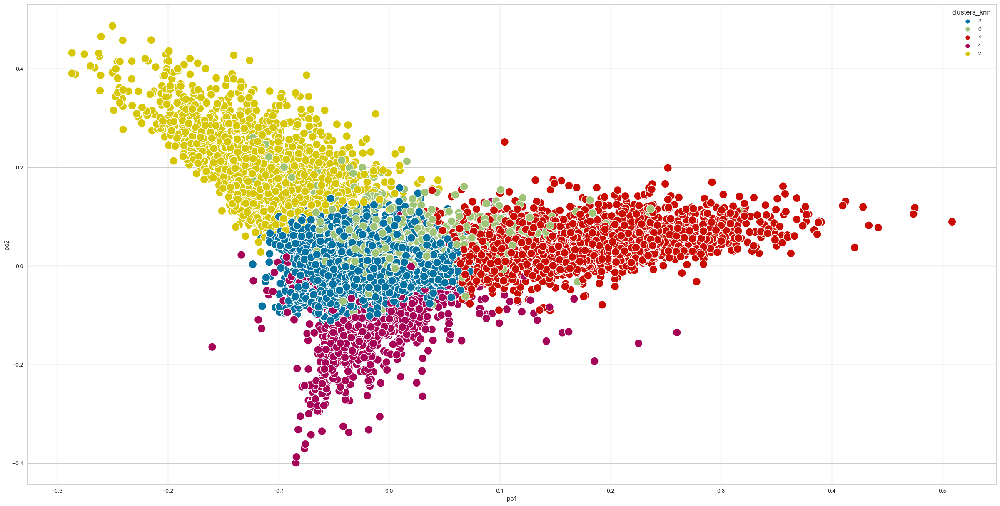

<Figure size 800x550 with 0 Axes>

In [88]:
# Plotting
plt.figure(figsize=(30,15))
sns.scatterplot(x='pc1', y='pc2', hue='clusters_knn', s=200, data=df_all)

# Annotate points
plt.show()
plt.savefig('2d_plot_tfidf_5Clusters', dpi = 300)

In [89]:
#Setting the clusters on their own data frame. 
cluster0 = df_all.loc[df_all['clusters_knn'] == '0']
cluster1 = df_all.loc[df_all['clusters_knn'] == '1']
cluster2 = df_all.loc[df_all['clusters_knn'] == '2']
cluster3 = df_all.loc[df_all['clusters_knn'] == '3']
cluster4 = df_all.loc[df_all['clusters_knn'] == '4']

In [97]:
print(len(cluster0))
print(len(cluster1))
print(len(cluster2))
print(len(cluster3))
print(len(cluster4))

1650
3482
1645
14150
1144


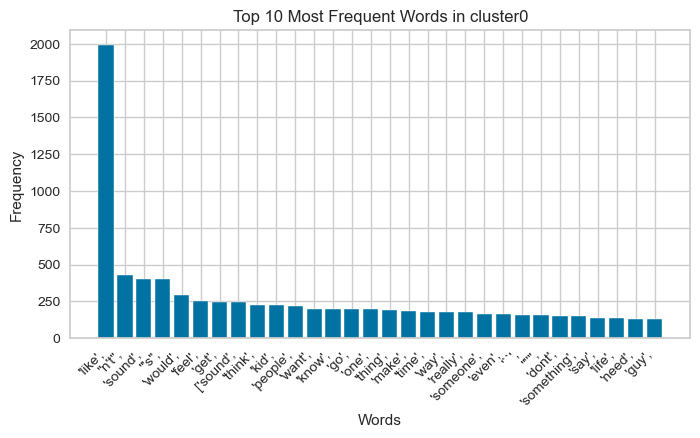

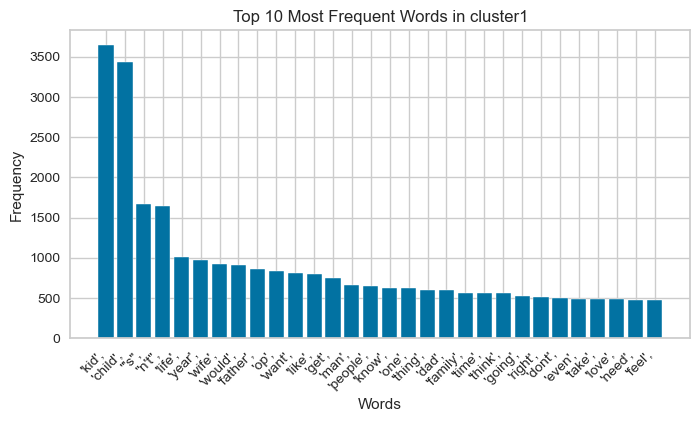

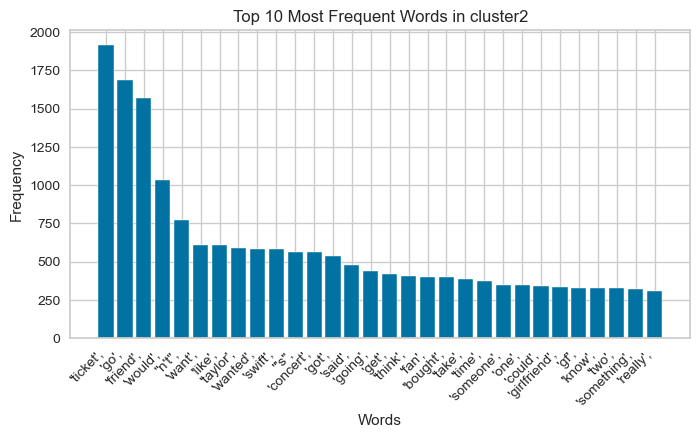

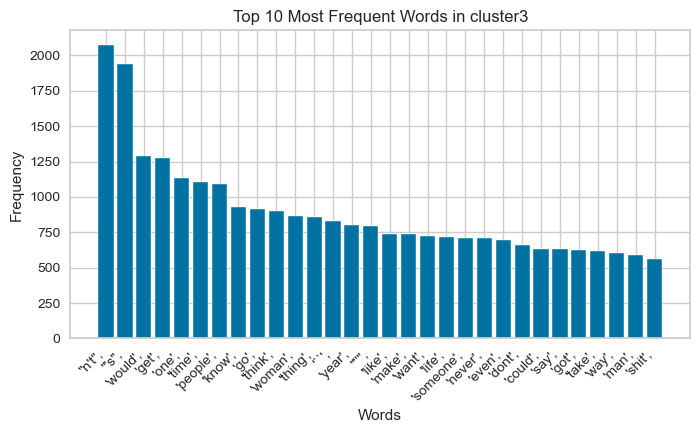

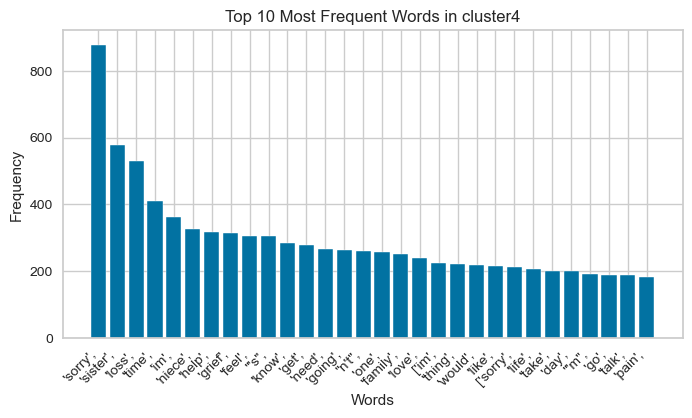

In [133]:
def plot_top_words(cluster_df, cluster_name):
    # Split the lemma strings into individual words
    words = [word for lemma in cluster_df['lemmas'] for word in lemma.split()]
    
    # Calculate the frequency distribution
    word_freq = FreqDist(words)
    
    # Get the top 10 most common words
    common_words = word_freq.most_common(30)
    words, frequencies = zip(*common_words)
    
    # Plot the bar chart
    plt.figure(figsize=(8, 4))
    plt.bar(words, frequencies)
    plt.title(f'Top 10 Most Frequent Words in {cluster_name}')
    plt.xlabel('Words')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45, ha='right')
    plt.show()

# Assuming you have dataframes for each cluster: cluster0, cluster1, ..., cluster4
# Replace cluster0, cluster1, ..., cluster4 with your actual dataframes
clusters = {
    'cluster0': cluster0,
    'cluster1': cluster1,
    'cluster2': cluster2,
    'cluster3': cluster3,
    'cluster4': cluster4
}

# Plot the top words for each cluster
for cluster_name, cluster_df in clusters.items():
    plot_top_words(cluster_df, cluster_name)

# About the Clusters
It’s worth mentioning before we start this analysis that all of the stories in this data are non-fiction, personal stories. Two of these were tagged as “venting”. I have checked this manually, and did not extract this through the Reddit APIs, as there were only 10 stories. 

After exploring all of the clusters, I have deduced that the topics of each cluster are: 

- Cluster 0: Relationships and family ‘drama’ - children, partners, cheating, abortion.

- Cluster 1: Parental issues and divorce.

- Cluster 2: Friendships and relationships.

- Cluster 3: Emotional reactions (the largest cluster, and hardest to identify a specific topic)

- Cluster 4: Grief & sympathy

Most of the clusters have a distinct separation between them. Clusters 1 and 2 have their extremes at opposite ends of the PCA scatterplot. Clusters 3 and 0 are heavily intertwined in the PCA scatterplot. This seems to make sense as familial relationships tend to provoke strong emotions.

# Sentiment Analysis

VAD assigns distinct numerical values to individual words across three dimensions: valence, arousal, and dominance. These dimensions delineate positivity and negativity, excitement and calmness, and the sense of control or lack thereof, respectively (Jones, Libert and Tynski, 2016).

Here I am first displaying the overall VAD distribution from the original dataset that contains over 40.000+ English words. 

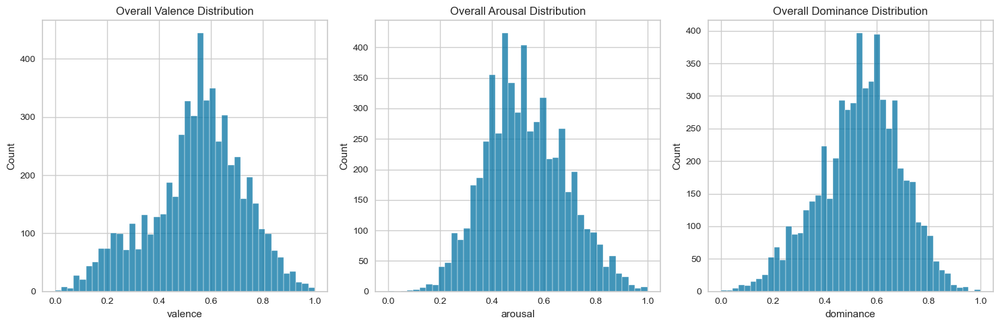

In [134]:
# VAD Values distribution of all original dataset 
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot valence distribution
sns.histplot(vad['valence'], ax=axes[0])
axes[0].set_title('Overall Valence Distribution')

# Plot arousal distribution
sns.histplot(vad['arousal'], ax=axes[1])
axes[1].set_title('Overall Arousal Distribution')

# Plot dominance distribution
sns.histplot(vad['dominance'], ax=axes[2])
axes[2].set_title('Overall Dominance Distribution')

plt.tight_layout()
plt.show()


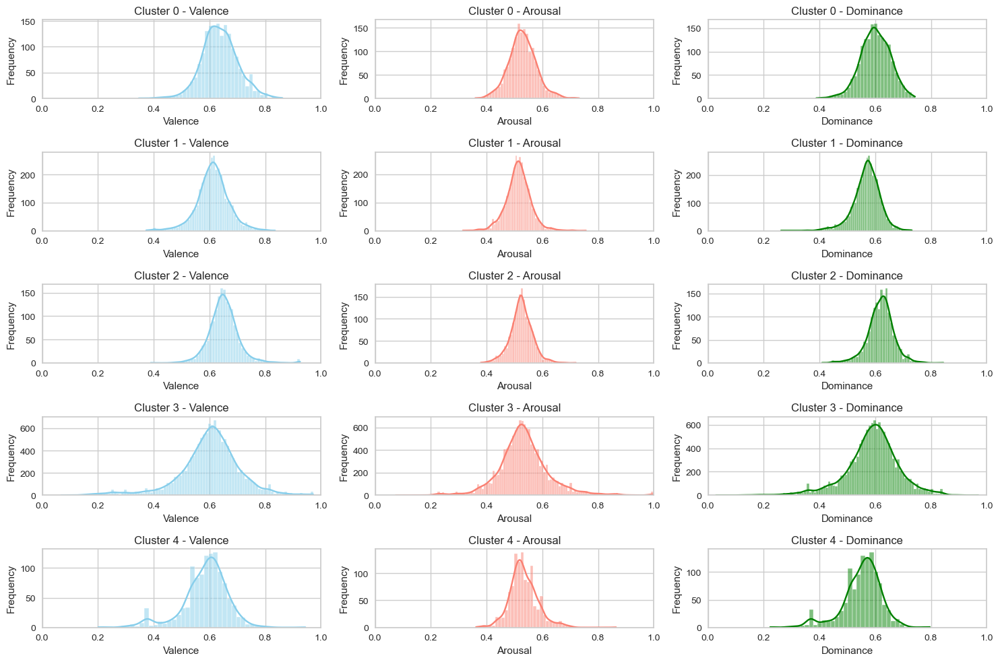

In [139]:
# histograms for Valence, Arousal, and Dominance for each cluster
fig, axes = plt.subplots(5, 3, figsize=(15, 10))

for i, cluster in enumerate([cluster0, cluster1, cluster2, cluster3, cluster4], start=0):
    ax_row = axes[i]
    
    # Plot Valence
    sns.histplot(cluster['Valence'], kde=True, color='skyblue', ax=ax_row[0])
    ax_row[0].set_title(f'Cluster {i} - Valence')
    ax_row[0].set_xlabel('Valence')
    ax_row[0].set_ylabel('Frequency')
    ax_row[0].set_xlim(0, 1)
    
    # Plot Arousal
    sns.histplot(cluster['Arousal'], kde=True, color='salmon', ax=ax_row[1])
    ax_row[1].set_title(f'Cluster {i} - Arousal')
    ax_row[1].set_xlabel('Arousal')
    ax_row[1].set_ylabel('Frequency')
    ax_row[1].set_xlim(0, 1)
    
    # Plot Dominance
    sns.histplot(cluster['Dominance'], kde=True, color='green', ax=ax_row[2])
    ax_row[2].set_title(f'Cluster {i} - Dominance')
    ax_row[2].set_xlabel('Dominance')
    ax_row[2].set_ylabel('Frequency')
    ax_row[2].set_xlim(0, 1)

plt.tight_layout()
plt.show()

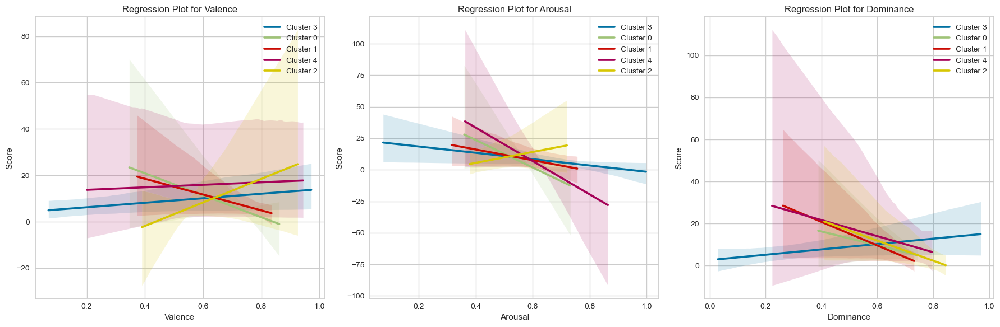

In [96]:
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import linregress

# Initialize subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Iterate over principal components
for pc, ax in zip(['Valence', 'Arousal', 'Dominance'], axes):
    # Plot each cluster's regression plot for the current principal component
    for cluster_label in df_all['clusters_knn'].unique():
        cluster_data = df_all[df_all['clusters_knn'] == cluster_label]
        sns.regplot(x=pc, y='score_', scatter=False, data=cluster_data, ax=ax, label=f'Cluster {cluster_label}')

    # Set labels and title for the current subplot
    ax.set_xlabel(pc)
    ax.set_ylabel('Score')
    ax.set_title(f'Regression Plot for {pc}')
    ax.legend()

# Adjust layout
plt.tight_layout()
plt.show()


In [98]:
print(cluster0['story_title'].describe())
print(cluster1['story_title'].describe())
print(cluster2['story_title'].describe())
print(cluster3['story_title'].describe())
print(cluster4['story_title'].describe())

count                                       1650
unique                                        10
top       Husband wants to reset his whole life.
freq                                         317
Name: story_title, dtype: object
count                                                  3482
unique                                                   10
top       I(32M) am divorcing my wife (33F) after findin...
freq                                                   2040
Name: story_title, dtype: object
count                                                  1645
unique                                                    9
top       I surprised my girlfriend with Taylor swift ti...
freq                                                   1576
Name: story_title, dtype: object
count                                                 14150
unique                                                   10
top       I thought she took me to the restroom to have ...
freq                                         

In [100]:
order_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]

In [101]:
# Initialize an empty dictionary to store cluster results
cluster_results = {}

# Iterate over clusters
for i in range(kmeans.n_clusters):
    cluster_label = f"Cluster {i}"
    terms_for_cluster = []
    
    # Get top terms for the current cluster
    for ind in order_centroids[i]:
        terms_for_cluster.append(feature_names[ind])
    
    # Store top terms for the cluster in the dictionary
    cluster_results[cluster_label] = terms_for_cluster

# Analysis VAD

Cluster 2 has the highest and most concentrated valance. This makes sense as Cluster 2 is comprised of positive and negative emotional responses, due to it being comprised of both elements of friendships and relationships. There’s a diversity of reactions here, due to elements of humour and tragedy.

Cluster 4 has a peak at the lowest valance values. Whereas the other clusters have a more uniform distribution.

The cluster that most breaks out of the normal distribution across all 3 elements of VAD is cluster 4. Perhaps suggesting that people’s responses to stories on the topic of Grief tend to be more erratic. In comparison, cluster 2 has a far more normal distribution of values. Perhaps this is because stories on the topic of friendships and relationships are more relatable, and thus a more unified response can be seen. 

Most clusters have a fairly normal distribution. However, the 

I attempted to discern if there was a correlation between upvotes and VAD. However, I could not find any clear correlation.

# Word embeddings

A word embedding is a form of representation for words. Word2Vec is an algorithmic training model from the Gensim Python Library. It adopts a technique that learns distributed representations of words by predicting the probability of words occurring together within a given context. Here I am also following the same steps followed for the topic modelling part.

In [41]:
reactions = all_stories_df['tokens']

In [42]:
model = gensim.models.Word2Vec(reactions, min_count= 20, vector_size = 300)

In [43]:
print(model.wv.index_to_key[:20])
#checking it works

["n't", "'s", 'like', 'kid', 'child', 'would', 'go', 'get', 'time', 'one', 'friend', 'want', 'know', 'people', 'think', 'life', 'thing', 'year', 'ticket', 'op']


In [44]:
#model.wv['story']

In [142]:
model.wv.most_similar(['grief'])

[('help', 0.9700658917427063),
 ('process', 0.9601308107376099),
 ('therapy', 0.9581113457679749),
 ('counseling', 0.950512170791626),
 ('trauma', 0.949463963508606),
 ('seek', 0.9421306848526001),
 ('therapist', 0.9406119585037231),
 ('hope', 0.939591109752655),
 ('please', 0.9362899661064148),
 ('traumatic', 0.9209103584289551)]

In [144]:
model.wv.doesnt_match(['kid', 'grief', 'relationship'])

'grief'

In [47]:
vocab = model.wv.index_to_key
vectors = [model.wv[i] for i in vocab]

df = pd.DataFrame(vectors)

In [48]:
df.columns = [str(i) for i in df.columns]

In [49]:
# Reduce the dimensionality of the data so we can plot it
pca_1 = PCA(n_components = 3)
comps_1 = pca_1.fit_transform(df)
pc_df_1 = pd.DataFrame(data = comps_1, columns = ['Principal Component '+str(i) for i in range(1, comps_1.shape[1]+1)])
df = pd.concat([df, pc_df_1], axis = 1)
df.index = vocab

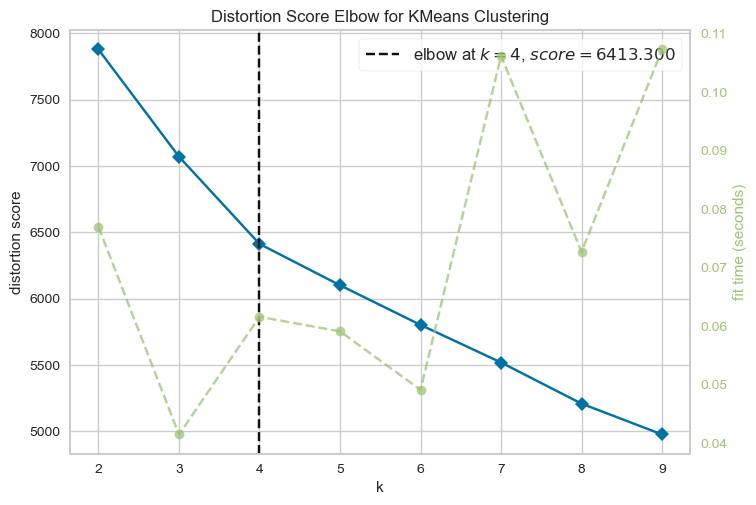

In [51]:
from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt

fig, ax = plt.subplots()

#the range of clusters
visualizer_wv = KElbowVisualizer(KMeans(n_init='auto'), k=(2, 10), ax=ax)

#apply it to the data 
visualizer_wv.fit(df)

# Set X-axis ticks
ax.set_xticks(range(2, 10))

# Show the visualizer
visualizer_wv.show()

plt.show()

In [52]:
# Clustering data to see what groups together
kmeans_wv = KMeans(n_clusters=4, random_state=0, n_init="auto").fit(df)

In [53]:
df['clusters_knn'] = [str(i) for i in kmeans_wv.labels_]

In [54]:
df

,0,1,2,3,4,5,6,7,8,9,...,294,295,296,297,298,299,Principal Component 1,Principal Component 2,Principal Component 3,clusters_knn
n't,-0.238590,0.425641,0.050237,0.275772,-0.275564,-0.087614,0.482032,1.031423,0.352910,-0.694987,...,0.919142,0.528299,-0.077057,0.077771,0.356497,-0.725259,-0.141517,1.967600,-0.893539,2
's,-0.440159,0.413819,0.036197,0.306032,0.180553,-0.243986,0.322142,0.438962,0.456739,-0.243067,...,0.895766,0.592775,0.081136,0.064483,0.233838,-0.101696,-0.455833,0.433011,1.136071,3
like,0.247979,0.084801,-0.188521,0.094742,-0.032105,-0.037237,0.426960,-0.403152,-0.274524,-0.190015,...,0.542139,0.476456,-0.075460,-0.000763,0.275215,-0.293684,-0.347420,1.052619,0.732216,3
kid,0.467514,0.067735,-0.127579,-0.382340,-0.033219,-0.097845,-0.097686,0.700505,-0.240832,-0.597290,...,0.513974,0.807326,-0.620359,-0.323448,0.317426,-0.475430,0.807481,-1.256322,-0.598083,1
child,0.438338,0.211824,0.074543,-0.305641,-0.043786,-0.252027,-0.218545,0.519189,-0.289831,-0.284222,...,0.532731,0.780224,-0.636685,0.107720,0.354841,-0.110704,-0.672380,-2.844147,-0.666908,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
employee,0.077902,0.078477,-0.008885,0.032983,0.008687,-0.039101,0.076473,0.191344,0.080180,-0.000231,...,0.045116,0.097907,0.021014,-0.022014,0.092464,0.010408,-0.148668,-0.133134,-0.011384,3
opening,0.041640,0.085989,-0.022518,0.034781,0.053974,-0.045206,0.099983,0.245779,0.096063,-0.075956,...,0.065231,0.116357,0.022228,-0.027205,0.078282,-0.043899,0.122285,0.088112,0.121370,3
confessed,0.029066,0.059718,-0.011997,0.035346,0.051716,-0.063176,0.097799,0.200954,0.074108,-0.065710,...,0.077218,0.120970,0.032023,-0.016692,0.098215,-0.041981,0.037779,-0.062549,0.254427,3
function,0.063526,0.103567,-0.014148,0.038247,0.030201,-0.062139,0.115714,0.235362,0.076334,-0.046985,...,0.088481,0.147880,0.014855,-0.010968,0.120387,-0.041316,-0.132181,-0.016120,0.082715,3


In [141]:
fig = px.scatter_3d(df, x='Principal Component 1', y='Principal Component 2', z='Principal Component 3',
              color='clusters_knn', hover_data=[df.index])

fig.update_traces(marker=dict(size=5, line=dict(width=2, color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.update_layout(
    width=800,
    height=600,
    margin=dict(l=0, r=0, t=0, b=0),
) #this is to make the plot bigger 

fig.show()


In [56]:
model.save("word2vec_.vec")

Findings of these resuls are in the following section.

# Reflection and Conclusion 
I identified specific topics from topic modelling with TF-IDF, ranging from a range from relationships and family drama to parental issues, friendships, emotional reactions, and grief. These all entail emotions that were easily analysed through VAD, yet the insights from that method were not as erratic as I would have assumed from only gathering the clusters. Unfortunately, the dataset does not contain enough range to display correlations with upvotes.

Furthermore, the clusters generated by Word2vec lacked the depth and specificity needed to derive meaningful insights about the storytelling elements and emotional nuances present in the dataset.

**Limitations**

This notebook has been incredibly challenging to interpret. Perhaps this is due the nature of the stories, and the type of reactions they cause. I would not be able to say they are ‘successful’ in any way, but they share something in common: They are real stories with flaws and problems that people encountered. Perhaps this is the reason why they are popular - relatability. They are relatable to many and therefore gather the same type of responses. But, what does that say about storytelling? I would not say with confidence that this work shows the trends of general storytelling. I would only be able to say that if more research is done. For instance, if these real stories cause so much engagement through empathy, emotional problems and relatability, could fictional stories cause the same? 

Engaging with NLP has given me notable challenges throughout this project. A significant part was the interpretation of data, as even knowledgeable sources concur that topic modelling and cluster analysis are methods prone to misinterpretation. This experience has shed light on an intriguing aspect of NLP: While it provides countless statistical techniques to counteract personal biases, our inherent limitations can still result in the misuse of these methods and ultimately, flawed data analysis. I believe that through these methods, I could not disseminate much more useful information than could have been obtained by manually studying the data. I believe this is because of the chosen dataset. There may simply be a limited amount that this dataset can tell us about storytelling. I say this because the results are not surprising, but expected by just seeing how emotional all the stories are. 

To use Reddit r/Stories as a data set, what would be better would be to compare data from the most and least popular stories. A differential analysis between these two groups would have yielded more insight into what makes a compelling story, as there would be flaws to analyse, and we could easily compare types of stories. 

One of the challenges encountered while using Word2vec for this project was the limited size of the pre-trained model. The dataset, Reddit r/Stories, encompasses a broad range of topics and emotions, but Word2vec's pre-trained model, despite being useful for various natural language processing tasks, wasn't extensive enough to capture the complete semantic complexity and richness of the stories.

An additional challenge arose due to the computational constraints of my computer. NLP's computationally intensive nature impeded progress and restricted further exploration within the project. In this instance, by computer’s CPU was the limiting factor. While this issue is rather personal, it prompted contemplation of broader implications on the accessibility of NLP research for individuals with limited financial resources. And whilst there are also cloud solutions to mitigate limited at-home computing power, these also come at a cost and aren’t particularly fast. This realisation underscores NLP as a domain primarily used by those with access to advanced equipment. Would that mean that this type of research could be done primarily by private companies, like those working in marketing, and sales? 

# Potential of NLP

NLP has remarkable potential to uncover trends and insights within narratives and storytelling when applied to a rich and diverse dataset. It can provide a deeper understanding of what makes a story engaging, its emotional impact on audiences, and cultural or societal factors that shape storytelling. The dataset explored here did not accomplish that, but by adding more sources of stories, it could have the potential to answer my questions.

# Bibliography

Albanese, F. (2022). *A Deeper Meaning: Topic Modeling in Python | Toptal®*. [online] Toptal Engineering Blog. Available at: https://www.toptal.com/python/topic-modeling-python [Accessed 23 Mar. 2024].

Arvai, K. (2020). *K-Means Clustering in Python: A Practical Guide – Real Python*. [online] realpython.com. Available at: https://realpython.com/k-means-clustering-python/ [Accessed 23 Mar. 2024].

Baruah, I.D. (2021). *Cheat sheet for implementing 7 methods for selecting the optimal number of clusters in Python*. [online] Medium. Available at: https://towardsdatascience.com/cheat-sheet-to-implementing-7-methods-for-selecting-optimal-number-of-clusters-in-python-898241e1d6ad#:~:text=As%20shown%20in%20Figure%206 [Accessed 23 Mar. 2024].

Brownlee, J. (2017). *How to Develop Word Embeddings in Python with Gensim*. [online] Machine Learning Mastery. Available at: https://machinelearningmastery.com/develop-word-embeddings-python-gensim/ [Accessed 20 Mar. 2024].

GeeksforGeeks (2019). *Python | Convert list of string to list of list*. [online] GeeksforGeeks. Available at: https://www.geeksforgeeks.org/python-convert-list-of-string-to-list-of-list/ [Accessed 24 Mar. 2024].

Jaadi, Z. (2019). *A Step by Step Explanation of Principal Component Analysis*. [online] Built In. Available at: https://builtin.com/data-science/step-step-explanation-principal-component-analysis [Accessed 24 Mar. 2024].

Jones, K., Libert, K. and Tynski, K. (2016). *The Emotional Combinations That Make Stories Go Viral*. [online] Harvard Business Review. Available at: https://hbr.org/2016/05/research-the-link-between-feeling-in-control-and-viral-content#:~:text=The%20findings%20indicate%20that%20individual.Joshi [Accessed 29 Mar. 2024].

Mattingly, W.J.B. (2021). *1. Introduction to TF-IDF — Introduction to Topic Modeling and Text Classification*. [online] topic-modeling.pythonhumanities.com. Available at: https://topic-modeling.pythonhumanities.com/02_01_intro_to_tf_idf.html [Accessed 23 Mar. 2024].

Nicholson, C.V. (n.d.). *A Beginner’s Guide to Word2Vec and Neural Word Embeddings*. [online] Pathmind. Available at: https://wiki.pathmind.com/word2vec [Accessed 21 Mar. 2024].

Python Tutorials for Digital Humanities (n.d.). *What are Topics and Clusters (Topic Modeling in Python for DH 01.02)*. [online] www.youtube.com. Available at: https://www.youtube.com/watch?v=0tkg7t2gsfY&list=PL2VXyKi-KpYttggRATQVmgFcQst3z6OlX&index=2&ab_channel=PythonTutorialsforDigitalHumanities [Accessed 24 Mar. 2024].

Rink, K. (2021). *Four mistakes in Clustering you should avoid*. [online] Medium. Available at: https://towardsdatascience.com/common-mistakes-in-cluster-analysis-and-how-to-avoid-them-eb960116d773 [Accessed 22 Mar. 2024].

Rink, K. (2022). *Best Practices for Visualizing Your Cluster Results*. [online] Medium. Available at: https://towardsdatascience.com/best-practices-for-visualizing-your-cluster-results-20a3baac7426 [Accessed 22 Mar. 2024].

scikit (n.d.). *Elbow Method — Yellowbrick v1.1 documentation*. [online] www.scikit-yb.org. Available at: https://www.scikit-yb.org/en/latest/api/cluster/elbow.html#:~:text=The%20elbow%20method%20runs%20k [Accessed 26 Mar. 2024].

Scikit Learn (2024). *6.2. Feature extraction — scikit-learn 0.22.2 documentation*. [online] scikit-learn.org. Available at: https://scikit-learn.org/stable/modules/feature_extraction.html [Accessed 20 Mar. 2024].

Stack Overflow (2015). *Simple way to measure cell execution time in ipython notebook*. [online] Stack Overflow. Available at: https://stackoverflow.com/questions/32565829/simple-way-to-measure-cell-execution-time-in-ipython-notebook [Accessed 22 Mar. 2024].

Stecanella, B. (2019). *Understanding TF-ID: A Simple Introduction*. [online] MonkeyLearn Blog. Available at: https://monkeylearn.com/blog/what-is-tf-idf/#:~:text=TF%2DIDF%20(term%20frequency%2D [Accessed 25 Mar. 2024]. 

#### This work contains 1497 words. 
-------------

#### Declarations
I have used chat GPT to work on this assignment mainly to check the code was written in the right format, for instance, using the correct brackets for indexing or applying functions. I did not copy a paste any code which was solely written by AI. I also automated some of the graphs displayed, to make them more neat. 